In [3]:
import tensorflow as tf
import sys

sys.path.append('../')

from Afterthought.Objective import Objective
from Afterthought.Parameterization import Parameterization
from Afterthought.Transformation import *
from Afterthought.Regularizer import *
from Afterthought.Optimizer import *
from Afterthought.Miscellaneous import *
from Afterthought.Attribution import *
from Afterthought.Wrapper import *

print(tf.__version__)
print(tf.config.list_physical_devices('GPU'))

2.10.0
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


# Model selection

In [4]:
# Model names: https://keras.io/api/applications/

model = Wrapper(model = 'MobileNet')

print(model.layers())

['input_1', 'conv1', 'conv1_bn', 'conv1_relu', 'conv_dw_1', 'conv_dw_1_bn', 'conv_dw_1_relu', 'conv_pw_1', 'conv_pw_1_bn', 'conv_pw_1_relu', 'conv_pad_2', 'conv_dw_2', 'conv_dw_2_bn', 'conv_dw_2_relu', 'conv_pw_2', 'conv_pw_2_bn', 'conv_pw_2_relu', 'conv_dw_3', 'conv_dw_3_bn', 'conv_dw_3_relu', 'conv_pw_3', 'conv_pw_3_bn', 'conv_pw_3_relu', 'conv_pad_4', 'conv_dw_4', 'conv_dw_4_bn', 'conv_dw_4_relu', 'conv_pw_4', 'conv_pw_4_bn', 'conv_pw_4_relu', 'conv_dw_5', 'conv_dw_5_bn', 'conv_dw_5_relu', 'conv_pw_5', 'conv_pw_5_bn', 'conv_pw_5_relu', 'conv_pad_6', 'conv_dw_6', 'conv_dw_6_bn', 'conv_dw_6_relu', 'conv_pw_6', 'conv_pw_6_bn', 'conv_pw_6_relu', 'conv_dw_7', 'conv_dw_7_bn', 'conv_dw_7_relu', 'conv_pw_7', 'conv_pw_7_bn', 'conv_pw_7_relu', 'conv_dw_8', 'conv_dw_8_bn', 'conv_dw_8_relu', 'conv_pw_8', 'conv_pw_8_bn', 'conv_pw_8_relu', 'conv_dw_9', 'conv_dw_9_bn', 'conv_dw_9_relu', 'conv_pw_9', 'conv_pw_9_bn', 'conv_pw_9_relu', 'conv_dw_10', 'conv_dw_10_bn', 'conv_dw_10_relu', 'conv_pw_10', '

# Objective operations

In [3]:
# Layer name
layer = 'conv_pw_10'

### Sum

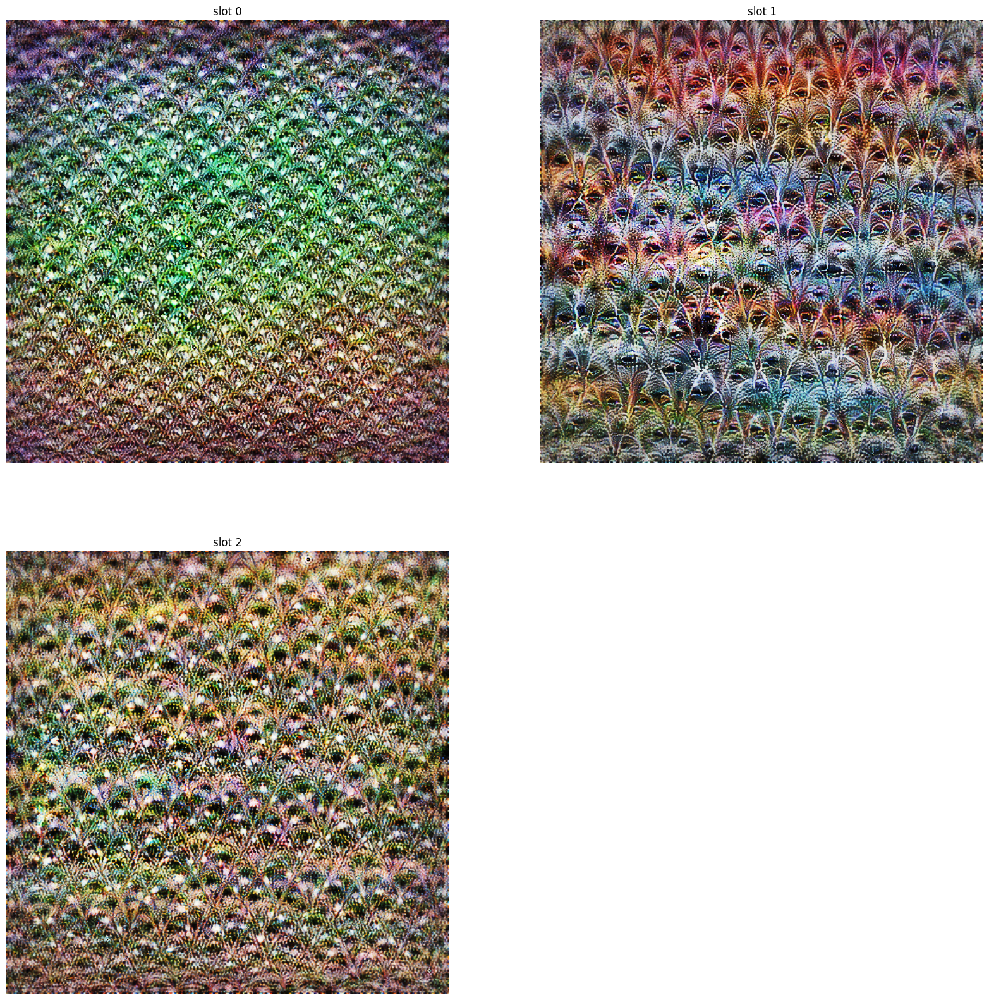

In [23]:
# Check activation maximization tutorial for more details
objective1 = Objective.channel(model = model, 
                               layer = layer, 
                               channels = 65, 
                               slots = 0) # slot on which this objective will be optimized

# Check activation maximization tutorial for more details
objective2 = Objective.channel(model = model, 
                               layer = layer, 
                               channels = 120, 
                               slots = 1) # slot on which this objective will be optimized

# It could be objective1 + objective2 but we want them to be optimized 
# at a different slots for showing purposes
sum = Objective.channel(model, layer, 65, slots = 2) +\
      Objective.channel(model, layer, 120, slots = 2)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512, slots = 3) # How many slots needed for this optimization

images = run(objective1 + objective2 + sum, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

### Product

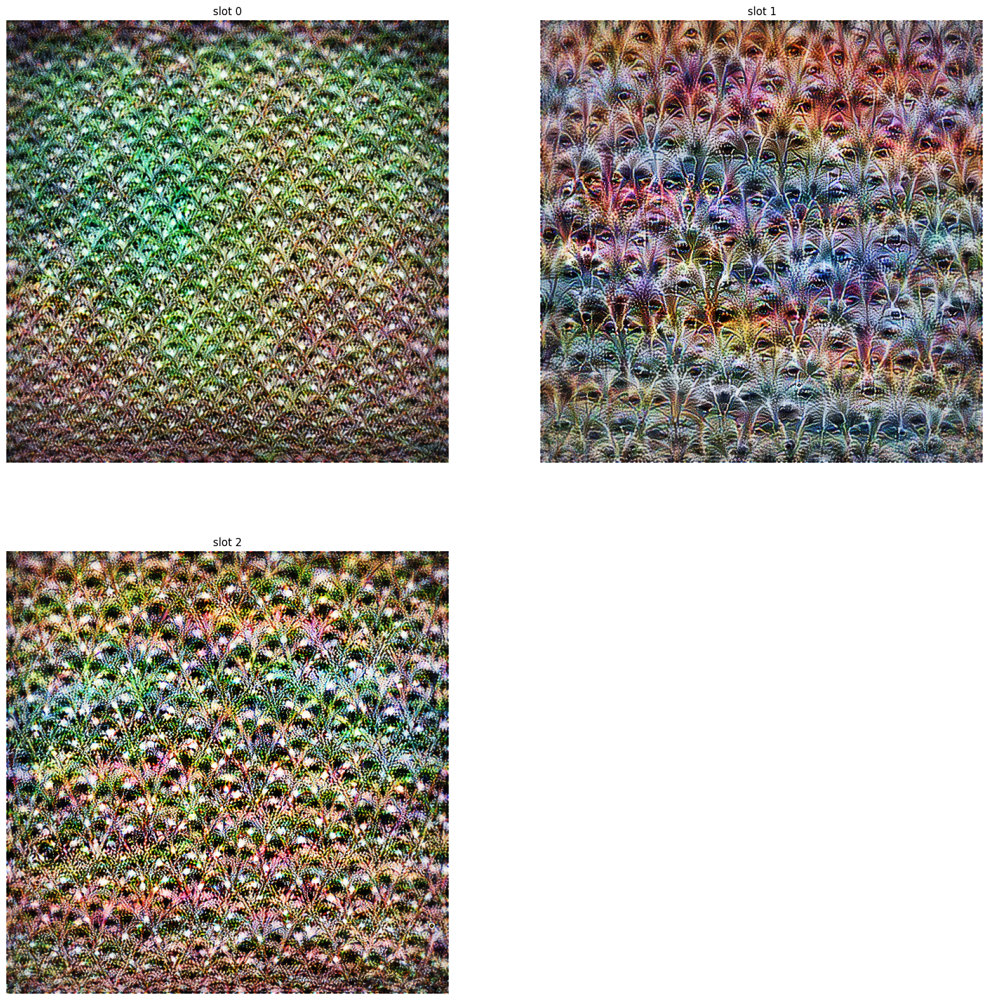

In [25]:
# Check activation maximization tutorial for more details
objective1 = Objective.channel(model = model, 
                               layer = layer, 
                               channels = 65, 
                               slots = 0) # slot on which this objective will be optimized

# Check activation maximization tutorial for more details
objective2 = Objective.channel(model = model, 
                               layer = layer, 
                               channels = 120, 
                               slots = 1) # slot on which this objective will be optimized

# It could be objective1 * objective2 but we want them to be optimized 
# at a different slots for showing purposes
product = Objective.channel(model, layer, channels = 65, slots = 2) *\
          Objective.channel(model, layer, channels = 120, slots = 2)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512, 
                                              slots = 3) # How many slots needed for this optimization


images = run(objective1 + objective2 + product, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

### Exponentiation

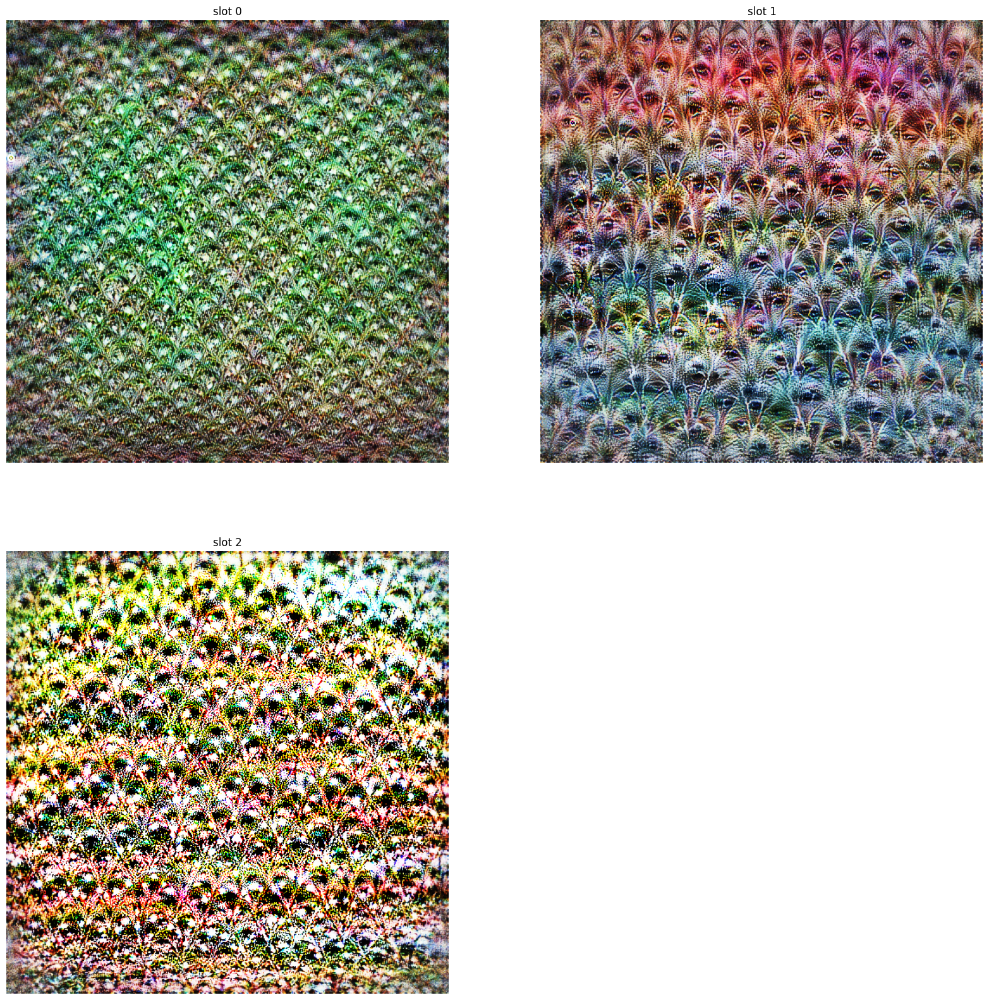

In [4]:
# Check activation maximization tutorial for more details
objective1 = Objective.channel(model = model, 
                               layer = layer, 
                               channels = 65, 
                               slots = 0) # slot on which this objective will be optimized

# Check activation maximization tutorial for more details
objective2 = Objective.channel(model = model, 
                               layer = layer, 
                               channels = 120, 
                               slots = 1) # slot on which this objective will be optimized

# It could be objective1 ** objective2 but we want them to be optimized 
# at a different slots for showing purposes
exponentiation = Objective.channel(model, layer, channels = 65, slots = 2) **\
                 Objective.channel(model, layer, channels = 120, slots = 2)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512, 
                                              slots = 3) # How many slots needed for this optimization


images = run(objective1 + objective2 + exponentiation, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

### Scaling

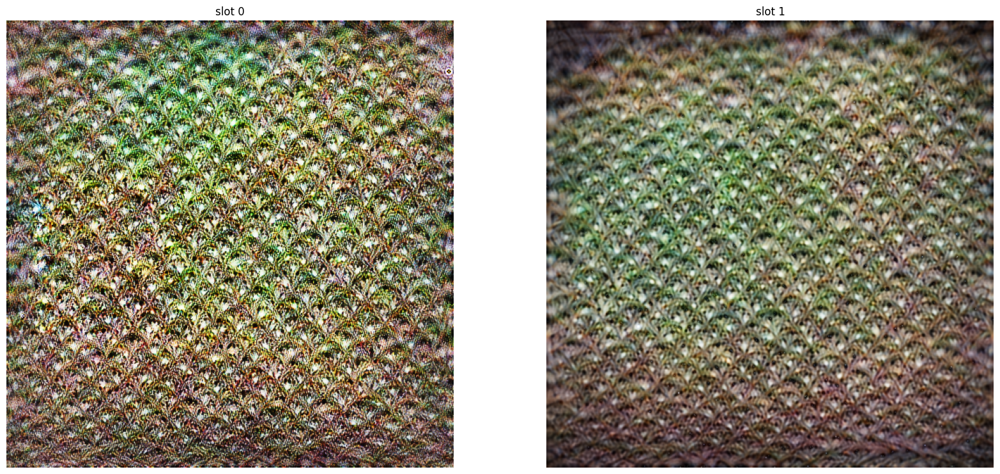

In [5]:
scale = 1e4
unscale = 1e-4

# Check activation maximization tutorial for more details
objective1 = scale * Objective.channel(model = model, 
                                       layer = layer, 
                                       channels = 65, 
                                       slots = 0) # slot on which this objective will be optimized

# Check activation maximization tutorial for more details
objective2 = unscale * Objective.channel(model = model, 
                                         layer = layer, 
                                         channels = 65, 
                                         slots = 1) # slot on which this objective will be optimized

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512, 
                                              slots = 2) # How many slots needed for this optimization


images = run(objective1 + objective2, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

# Model logits

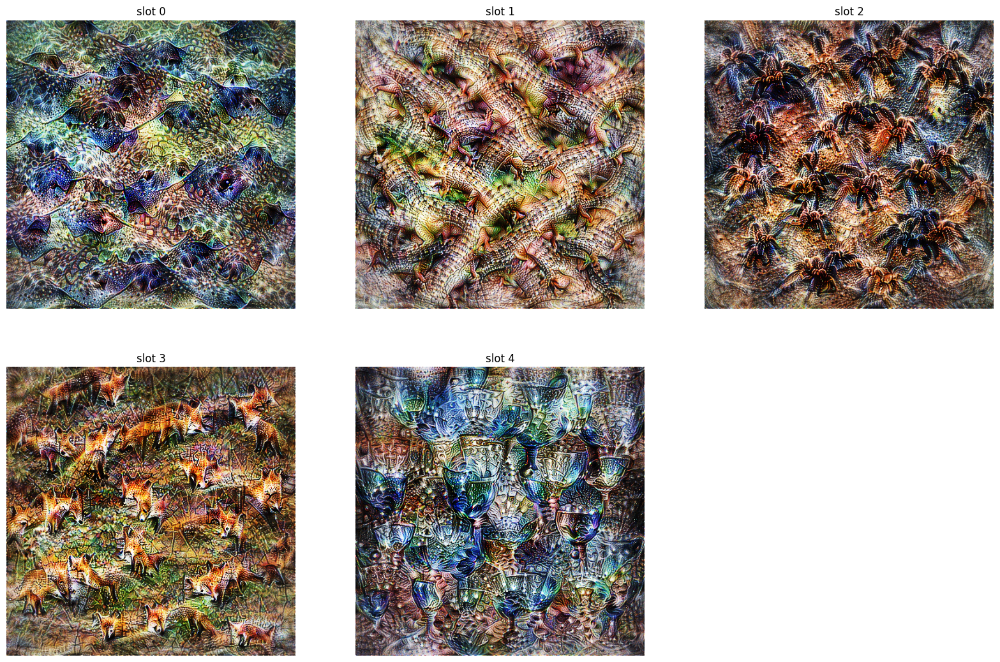

In [28]:
# Last layer (model predictions)
layer = -1

# Class indexes for model classification
classes = [6, # stingray
           44, # alligator lizard
           76, # tarantula
           277, # red fox
           572 # goblet
          ]

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

for c in classes:
    # Check activation maximization tutorial for more details
    objective = Objective.channel(model = model, 
                                  layer = -1,
                                  channels = c)

    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      verbose = False)[0])

plot_all(images)

# Directions

In [43]:
# Model names: https://keras.io/api/applications/

model = Wrapper(model = 'InceptionV3')

print(model.layers())

# Layer name
layer = 'mixed5'

size = model.get_layer_output_shape(layer)[-1]

['input_4', 'conv2d_188', 'batch_normalization_188', 'activation_188', 'conv2d_189', 'batch_normalization_189', 'activation_189', 'conv2d_190', 'batch_normalization_190', 'activation_190', 'max_pooling2d_8', 'conv2d_191', 'batch_normalization_191', 'activation_191', 'conv2d_192', 'batch_normalization_192', 'activation_192', 'max_pooling2d_9', 'conv2d_196', 'batch_normalization_196', 'activation_196', 'conv2d_194', 'conv2d_197', 'batch_normalization_194', 'batch_normalization_197', 'activation_194', 'activation_197', 'average_pooling2d_18', 'conv2d_193', 'conv2d_195', 'conv2d_198', 'conv2d_199', 'batch_normalization_193', 'batch_normalization_195', 'batch_normalization_198', 'batch_normalization_199', 'activation_193', 'activation_195', 'activation_198', 'activation_199', 'mixed0', 'conv2d_203', 'batch_normalization_203', 'activation_203', 'conv2d_201', 'conv2d_204', 'batch_normalization_201', 'batch_normalization_204', 'activation_201', 'activation_204', 'average_pooling2d_19', 'conv2d

## Random vectors

#### Directions

In [44]:
directions = np.random.uniform(0, 1, (size,))

#### Activation maximization

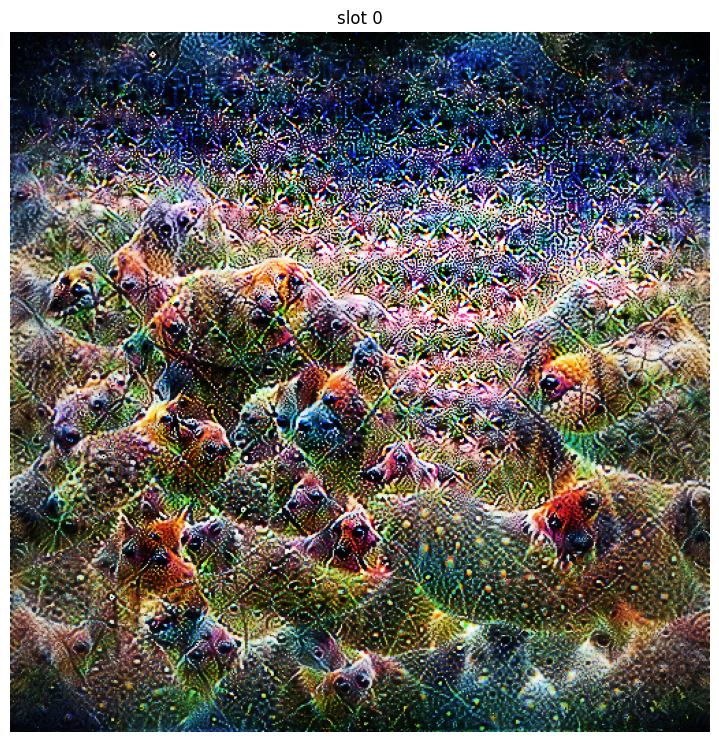

In [45]:
objective = Objective.direction(model = model,
                                layer = layer,
                                vectors = directions)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = run(objective, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

## 0 to size directions

#### Directions

In [46]:
directions = np.arange(size)

### Activation Maximization

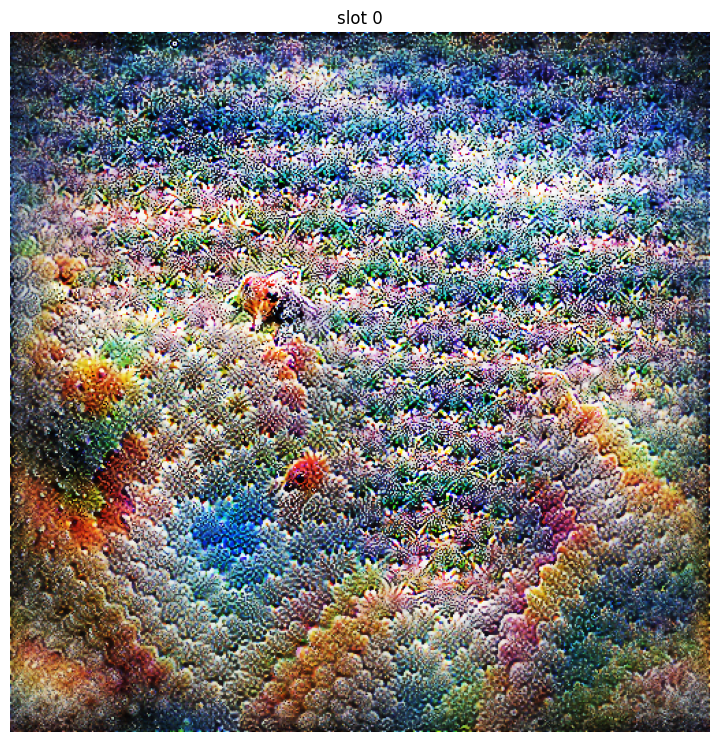

In [47]:
objective = Objective.direction(model = model,
                                layer = layer,
                                vectors = directions)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = run(objective, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

## 0 to size directions - normalized

#### Directions

In [48]:
directions = np.arange(0, 1, 1 / size)

#### Activation Maximization

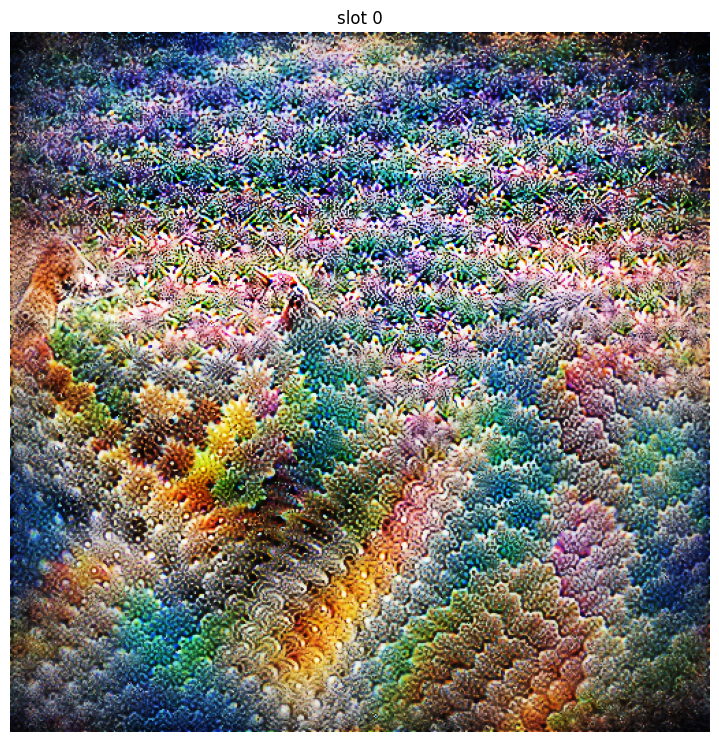

In [49]:
objective = Objective.direction(model = model,
                                layer = layer,
                                vectors = directions)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = run(objective, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

## 0 to size directions - normalized and inverted

#### Directions

In [50]:
directions = np.flip(np.arange(0, 1, 1 / size))

#### Activation Maximization

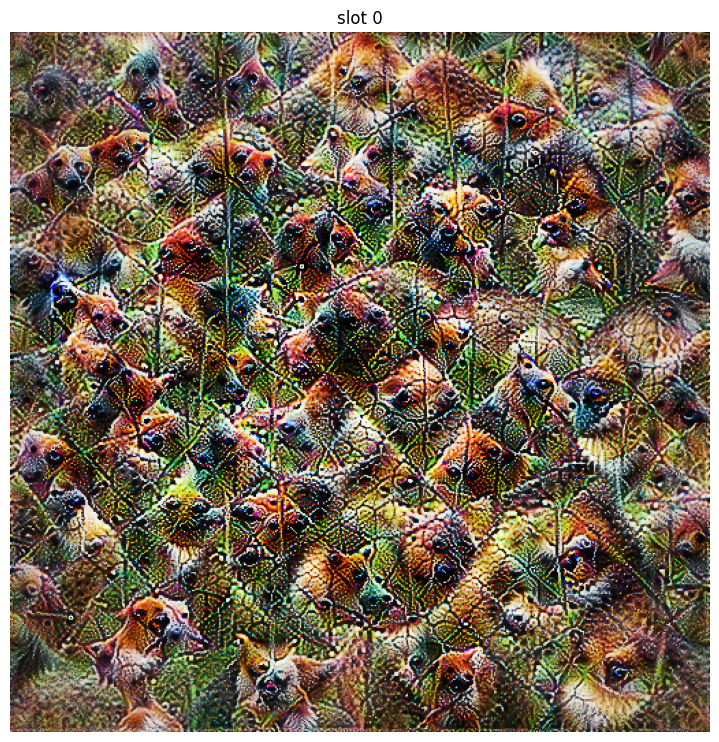

In [51]:
objective = Objective.direction(model = model,
                                layer = layer,
                                vectors = directions)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = run(objective, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

# Diversity

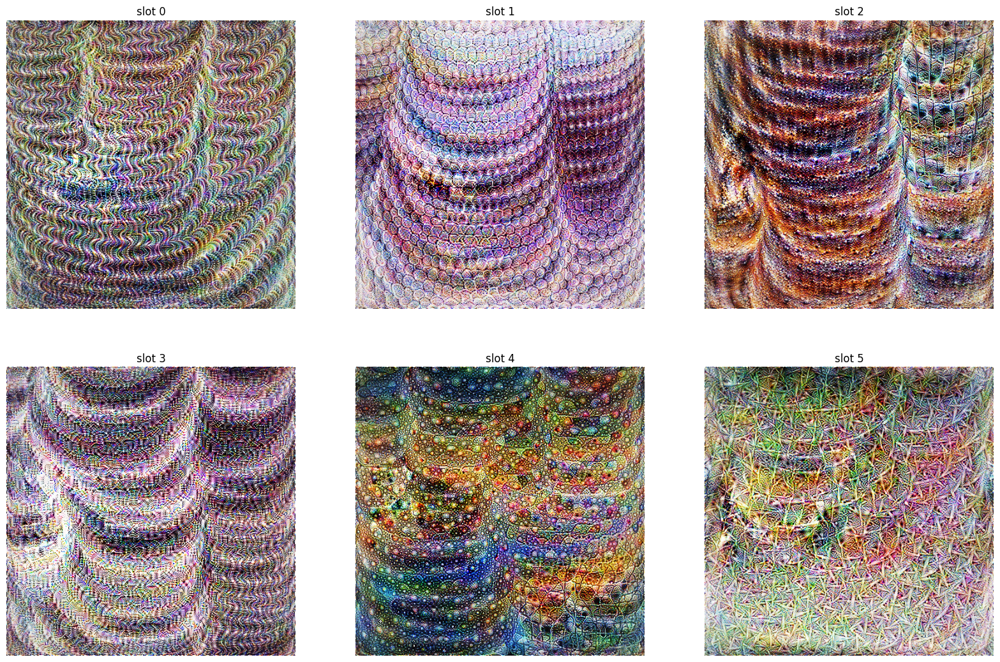

In [56]:
# To much power overwrites the channel objective, so the key value is around 0.5
POWER = 0.5

# Check activation maximization tutorial for more details
objective = Objective.channel(model, layer, 256) +\
            POWER * Objective.diversity(model, layer) # applies layer characteristics to all slots

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512, 
                                              slots = 6) # number of images to use diversity

images = run(objective, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

# Channel interpolation

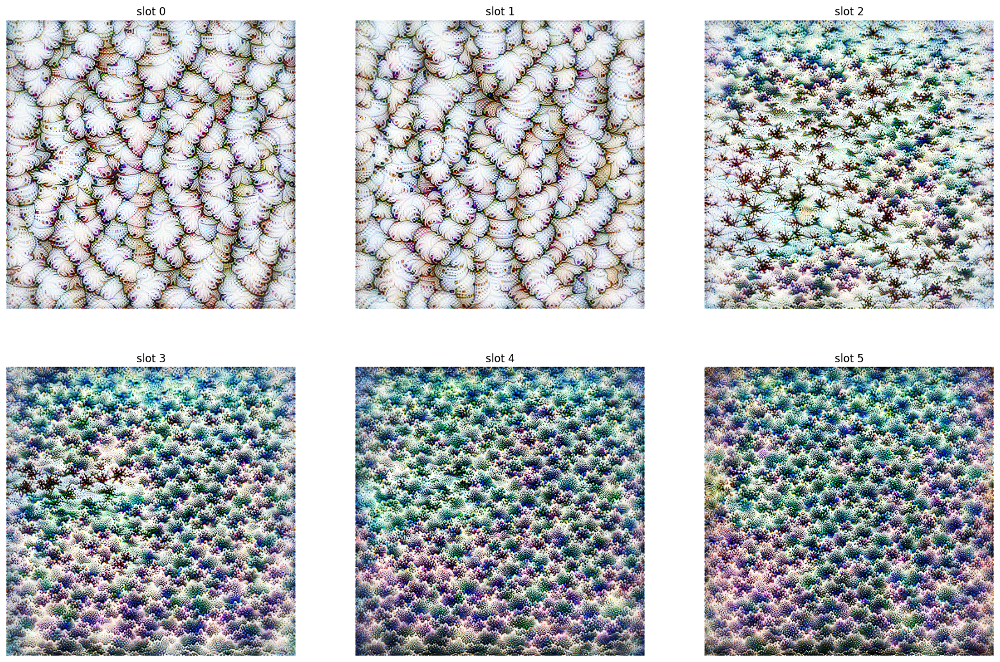

In [54]:
objective = Objective.channel_interpolate(model, 
                                          layer1 = layer, 
                                          channel1 = 76, 
                                          layer2 = layer, 
                                          channel2 = 567)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512, 
                                              slots = 6) # number of interpolation steps

images = run(objective, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)

# Pathing

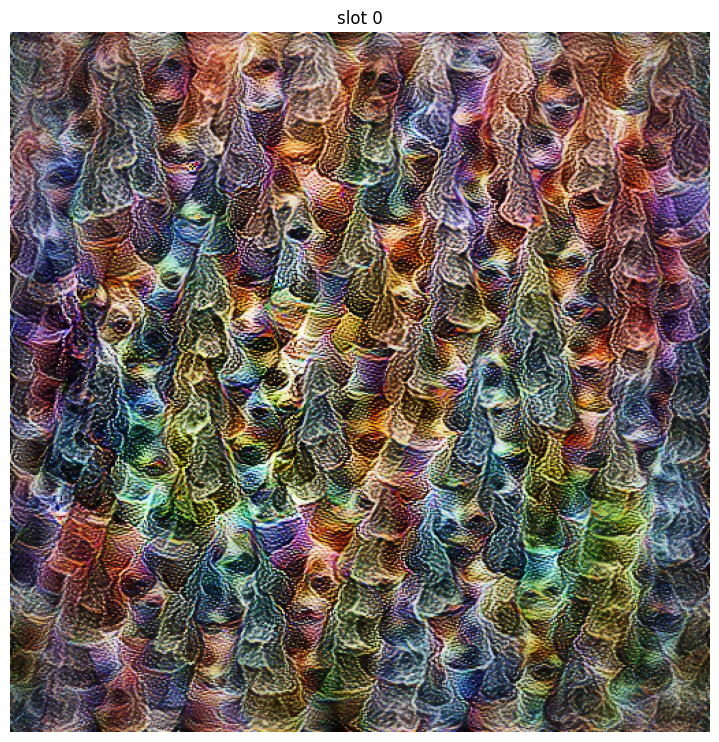

In [6]:
# channel(s) to optimize at each layer
channels = 3

# Layer indexes interval
interval = (35, 75)

objective = Objective.pathing(model = model,
                              channels = channels,
                              interval = interval)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = run(objective, parameterization, 
             steps = 1000, learning_rate = 0.1,
             verbose = False)

plot_all(images)